In [1]:
import pandas as pd
import numpy as np
import pybnesian as pbn
import matplotlib.pyplot as plt
import os
import glob
import time
from util_draw   import *

/tmp/ipykernel_24082/3104395093.py:73: UserWarning: The figure layout has changed to tight
  fig.tight_layout()


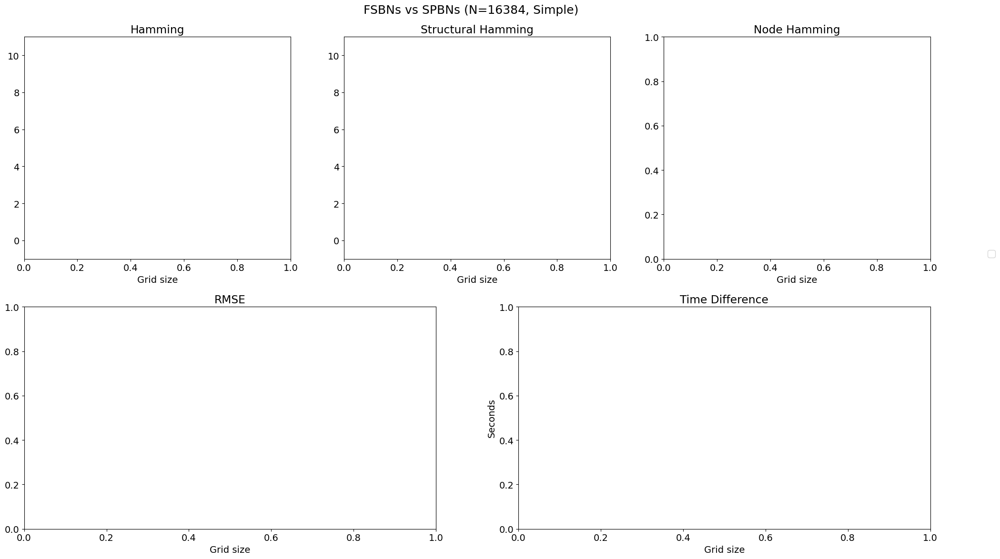

In [2]:
paths = ['results/NfIX/exp0/N16384/*.csv']
for path in paths:
    ress = glob.glob(path)
    ress = sorted(ress)
    hasM = path.split('/')[3][1:]


    plt.rcParams.update({'font.size': 14})
    fig = plt.figure(figsize=(20, 12), layout="constrained")
    fig.suptitle(f'FSBNs vs SPBNs (N={hasM}, Simple)', fontsize=18)
    gs0 = fig.add_gridspec(2, 1)
    gs00 = gs0[0].subgridspec(1, 3)
    gs10 = gs0[1].subgridspec(1, 2)


    ax00 = fig.add_subplot(gs00[0, 0])
    ax00.set_title('Hamming')
    ax00.set_xlabel('Grid size')
    ax00.set_ylim(-1,11)

    ax01 = fig.add_subplot(gs00[0, 1])
    ax01.set_title('Structural Hamming')
    ax01.set_xlabel('Grid size')
    ax01.set_ylim(-1,11)

    ax02 = fig.add_subplot(gs00[0, 2])
    ax02.set_title('Node Hamming')
    ax02.set_xlabel('Grid size')

    ax10 = fig.add_subplot(gs10[0, 0])  
    ax10.set_title('RMSE')
    ax10.set_xlabel('Grid size')
    ax10.set_ylim(0,1)

    ax11 = fig.add_subplot(gs10[0, 1])
    ax11.set_title('Time Difference')
    ax11.set_xlabel('Grid size')
    ax11.set_ylabel('Seconds')

    for nrs, res in enumerate(ress):
        filename = os.path.basename(res).split('_')[1]
        df0 = pd.read_csv(res)

        
        df0['time_diff'] = df0['time_spbn'] - df0['time_fbn']
        df = df0.groupby('grid').mean().reset_index()
        dfstev = df0.groupby('grid').std().reset_index()


        ax00.errorbar(x=df['grid'], y=df['hamming'], yerr=dfstev['hamming'], fmt='o', linestyle='-', capsize=4, markersize=3, label=filename)
        ax00.grid(True)
        
        ax01.errorbar(x=df['grid'], y=df['shamming'], yerr=dfstev['shamming'], fmt='o', linestyle='-', capsize=4, markersize=3, label=filename)
        ax01.grid(True)
        
        ax02.errorbar(x=df['grid'], y=df['type_hamming'], yerr=dfstev['type_hamming'], fmt='o', linestyle='-', capsize=4, markersize=3, label=filename)   
        ax02.grid(True)
        
        ax10.errorbar(x=df['grid'], y=df['rmse'], yerr=dfstev['rmse'], fmt='o', linestyle='-',  capsize=4, markersize=3, label=filename)
        ax10.grid(True)

        ax11.errorbar(x=df['grid'], y=df['time_diff'], yerr=dfstev['time_diff'], fmt='o', linestyle='-',  capsize=4, markersize=3, label=filename)
        ax11.grid(True)


    handles, labels = [], []
    for ax in [ax00, ax01, ax02, ax10, ax11]:
        for handle, label in zip(*ax.get_legend_handles_labels()):
            if label not in labels:  # Check to avoid duplicates
                handles.append(handle)
                labels.append(label)
    fig.legend(handles, labels,loc='upper right', bbox_to_anchor=(1.05, 0.55), borderaxespad=0.)
    fig.tight_layout()
    fig.show()  


In [3]:
def return_results(results, nodemap):
    map_types = {0: pbn.LinearGaussianCPDType(), 1:pbn.CKDEType(), 2:pbn.FBKernelType()}
    time = results['time']
    slogl = results['slogl']
    network = results['network']

    
    nodetypes = np.array(network['node_types']).reshape(-1, 2)
    nodes_df = pd.DataFrame(nodetypes, columns=['node', 'type'])
    nodes_df.replace({'LinearGaussianFactor':0, 'CKDEFactor':1, 'FBKernelType':2}, inplace=True)
    nodes_df = nodes_df.groupby('node').mean().reset_index()
    nodes_df.type = nodes_df.type.astype(int)
    avg_node_types = [(row.node, map_types[row.type])  for row in nodes_df.itertuples()]
    avg_nodes = nodes_df['node'].values

    dags = np.array(network['DAGS'])
    avg_network = average_dags(dags,threshold=2/3)

    lengnodes = avg_network.shape[0]
    avg_arcs = []
    for i in range(lengnodes):
        for j in range(lengnodes):
            val_ij = avg_network[i,j]
            val_ji = avg_network[j,i]
            if i!=j and (val_ij>0 and val_ji==0):
                avg_arcs.append((nodemap[str(i)],nodemap[str(j)]))
            elif (val_ij>0 and val_ji>0):
                print((nodemap[str(i)],nodemap[str(j)]))
    
    network_kargs = {'node_types':avg_node_types, 'arcs':avg_arcs, 'nodes':avg_nodes}
    return time, slogl, network_kargs


/tmp/ipykernel_24082/2907157354.py:10: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  nodes_df.replace({'LinearGaussianFactor':0, 'CKDEFactor':1, 'FBKernelType':2}, inplace=True)
/tmp/ipykernel_24082/2907157354.py:10: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  nodes_df.replace({'LinearGaussianFactor':0, 'CKDEFactor':1, 'FBKernelType':2}, inplace=True)
/tmp/ipykernel_24082/2907157354.py:10: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitl

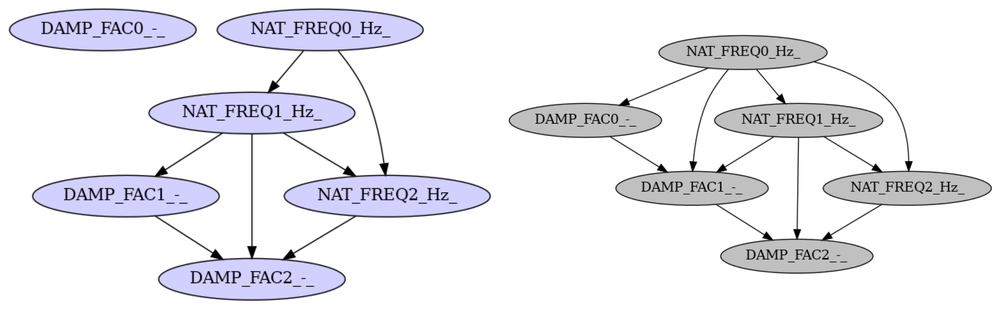

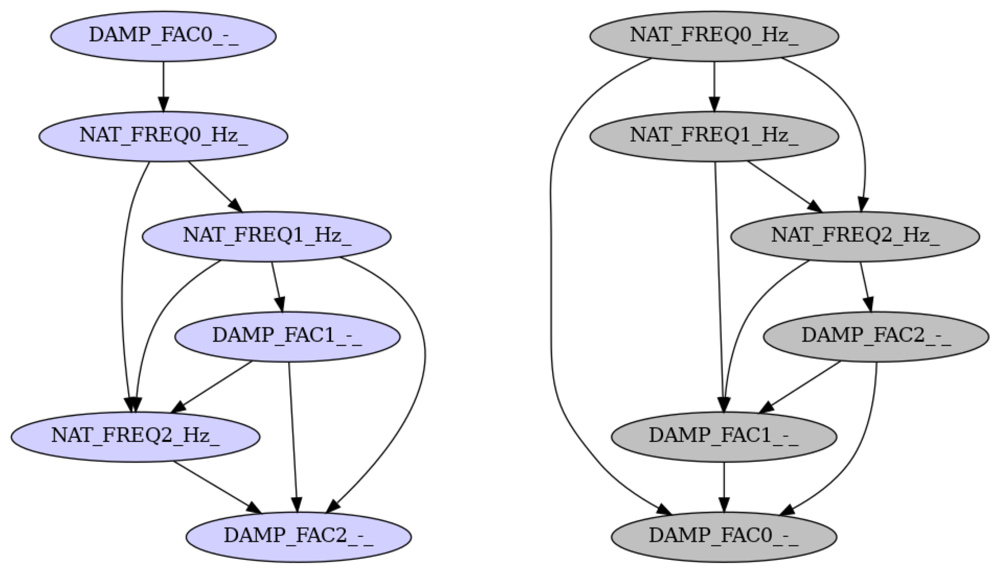

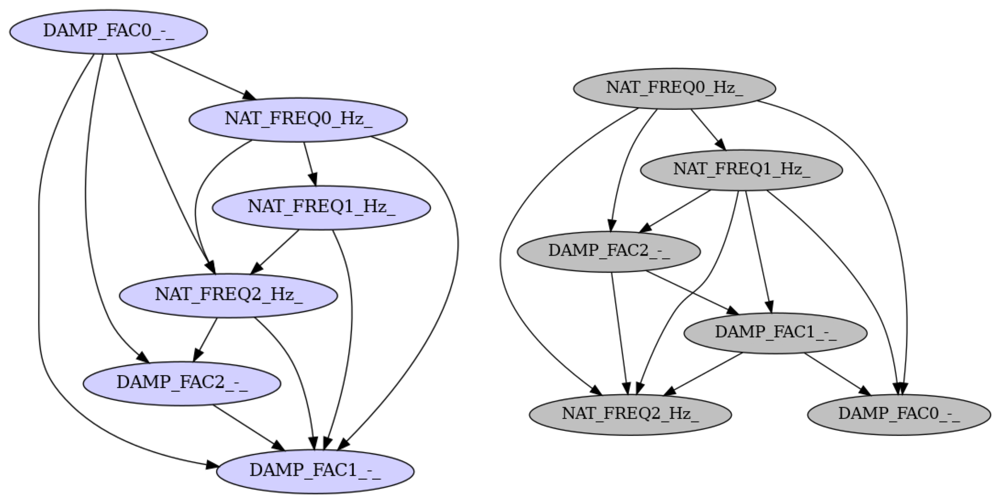

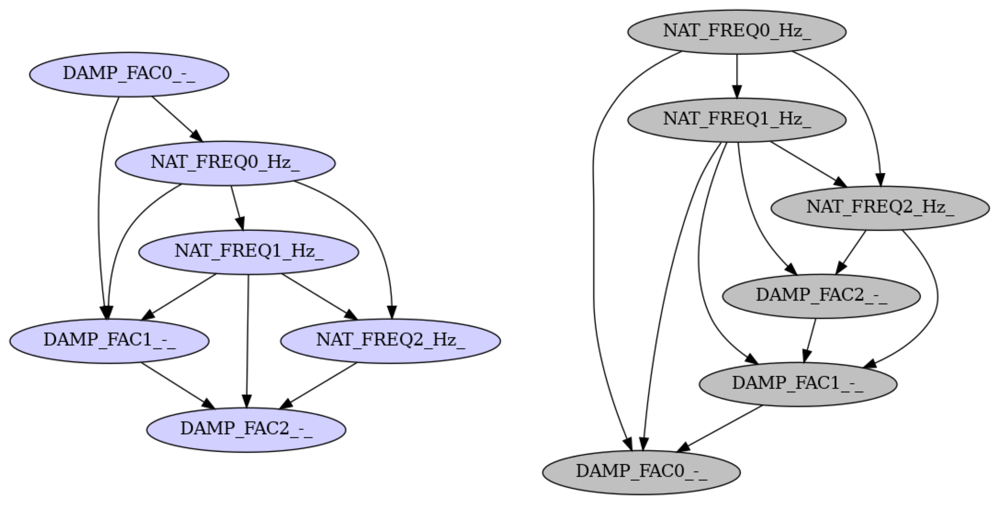

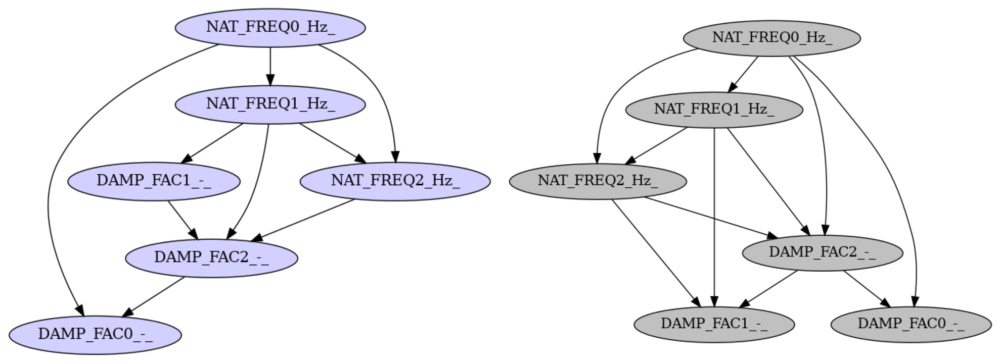

...

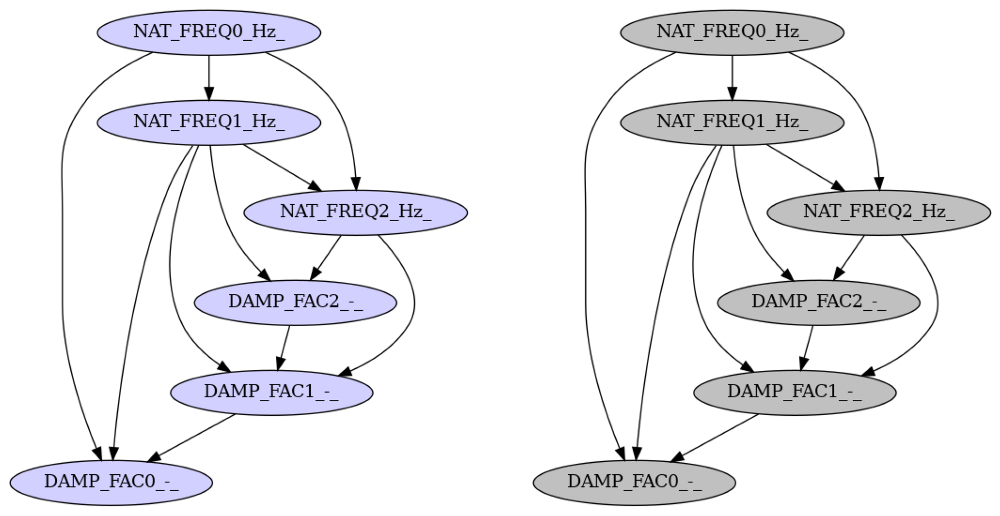

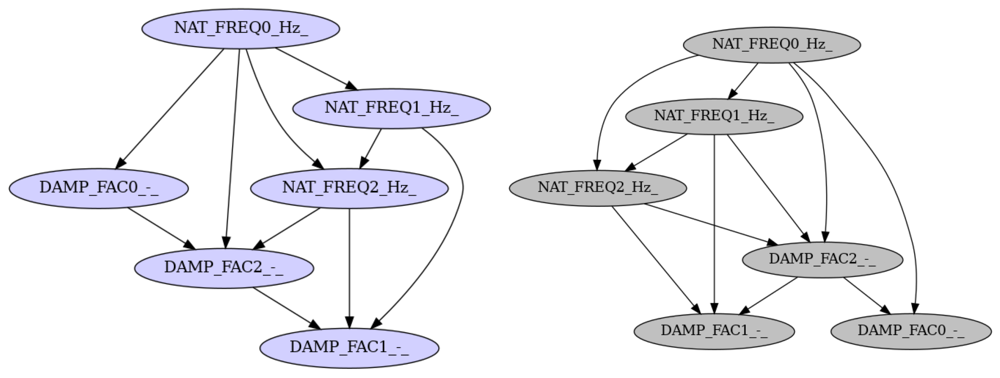

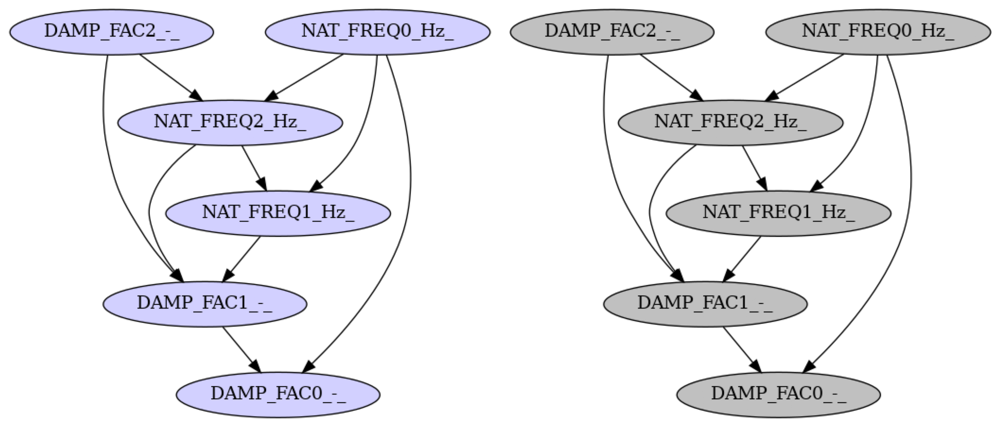

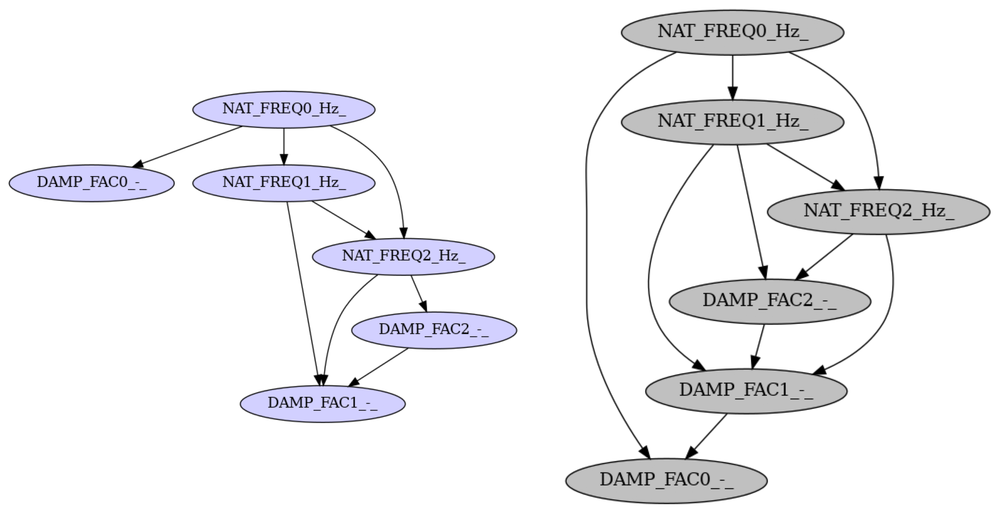

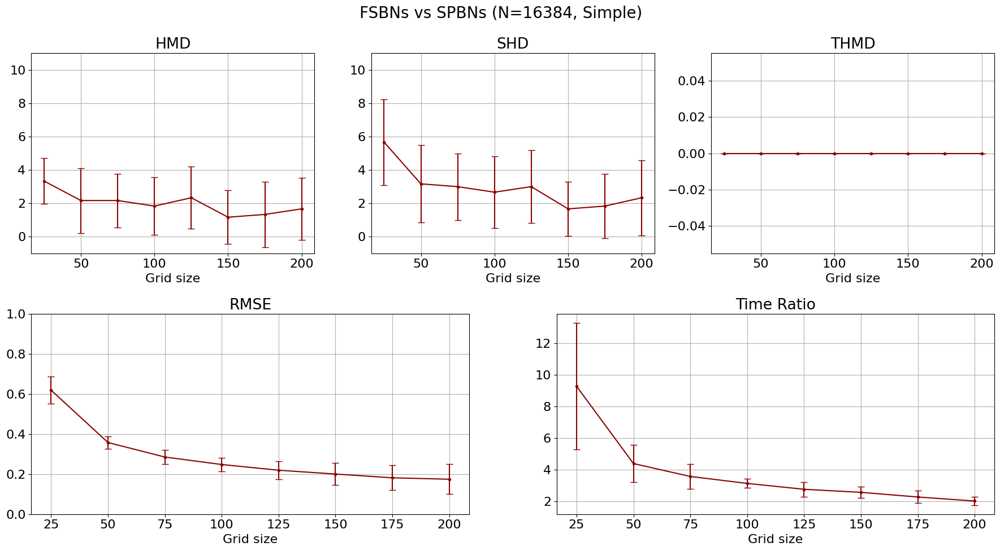

,grid,span,rmse,hamming,shamming,type_hamming,fbn_time,spbn_time,fbn_slogl,spbn_slogl,bridge,time_ratio
0,25,e1v1,0.517514,3.0,3.0,0.0,17.777523,231.839910,-35977.662791,-35442.016496,1,13.041182
0,25,e1v2,0.632299,3.0,6.0,0.0,18.307137,255.889034,-34366.413752,-33857.842872,1,13.977556
0,25,e1v3,0.580595,6.0,10.0,0.0,36.179475,263.690404,-34299.486241,-33857.184445,1,7.288398
0,25,e2v1,0.696685,3.0,6.0,0.0,41.444044,206.449875,-33165.932119,-32597.652417,2,4.981412
0,25,e2v2,0.601387,2.0,3.0,0.0,20.077097,224.502449,-35053.222776,-34377.690494,2,11.182017
0,25,e2v3,0.688989,3.0,6.0,0.0,40.417731,207.977546,-35141.851604,-34388.601623,2,5.145701
0,50,e1v1,0.335849,5.0,7.0,0.0,80.804058,227.079471,-35610.313694,-35412.340084,1,2.810248
0,50,e1v2,0.349443,4.0,4.0,0.0,46.360623,253.192539,-34111.182371,-33929.643181,1,5.461370
0,50,e1v3,0.378329,2.0,4.0,0.0,48.652337,286.573545,-34184.268758,-33876.315849,1,5.890232
0,50,e2v1,0.405764,1.0,1.0,0.0,44.710015,207.829278,-32926.565453,-32534.043755,2,4.648383


In [4]:
import json
from util_funcs import *


# Load the dictionary from the JSON file
with open('results/Nfix/exp7_simple/N16384/Nfixed2.json', 'r') as json_file:
    results_dict = json.load(json_file)

grid = [int(k) for k in results_dict.keys()]
stringify = lambda x: [[k,str(v)] for k,v in x]
avg_metrics = []
avg_spans_distances = []

for msize in grid:
    dag_list_fbn, dag_list_spbn, nodetypes_fbn, nodetypes_spbn = [], [], [], []

    for span, results in results_dict[str(msize)].items():
        
        nodemap = results['nodemap']
        rmse = results['distances']['rmse']
        fbn_time, fbn_slogl, avg_fbn_kargs = return_results(results['FSBN'],nodemap)
        spbn_time, spbn_slogl, avg_spbn_kargs = return_results(results['SPBN'],nodemap)
        
        avg_fbn = pbn.FourierNetwork(**avg_fbn_kargs)
        avg_spbn = pbn.SemiparametricBN(**avg_spbn_kargs)
        nodes_fbn = avg_fbn.node_types()
        nodes_spbn = avg_spbn.node_types()
        dag_matrix_fbn = arcs_to_DAG(avg_fbn.arcs(), nodemap)
        dag_matrix_spbn = arcs_to_DAG(avg_spbn.arcs(), nodemap)

        dag_list_fbn.append(dag_matrix_fbn.tolist())
        dag_list_spbn.append(dag_matrix_spbn.tolist())
        nodetypes_spbn.append(stringify(nodes_spbn.items()))
        nodetypes_fbn.append(stringify(nodes_fbn.items()))
        
        
        pdag_fbn = avg_fbn.clone()
        pdag_fbn = pdag_fbn.graph().to_pdag()
        pdag_spbn = avg_spbn.clone()
        pdag_spbn = pdag_spbn.graph().to_pdag()


        path = f'results/Nfix/exp7_simple/N16384/avg_nets/M{msize}/{span}'
        if not os.path.exists(path):
            os.makedirs(path)
        draw_model(avg_fbn,path+'/fsbn')
        draw_model(avg_spbn,path+'/spbn')
        draw_model_pdag(pdag_fbn,path+'/fsbn_pdag')
        draw_model_pdag(pdag_spbn,path+'/spbn_pdag')

        fig = plt.figure(figsize=(20,10))
        for m, model in enumerate([avg_fbn, avg_spbn]):
            ax = fig.add_subplot(1,2,m+1)
            plot_both_models(model, ax)
            
        fig.tight_layout()
        fig.savefig(path + '/both.pdf', format='pdf',bbox_inches="tight")
        # fig.show()
        
        hamming = hamming_distance(avg_fbn.arcs(), avg_spbn.arcs(), nodemap)
        shamming = structural_hamming_distance(avg_fbn.arcs(), avg_spbn.arcs(),)
        type_hamming = node_type_hamming_distance(avg_fbn.node_types(), avg_spbn.node_types())

        # hamming  = np.array(results['distances']['hmd']).astype(float)
        # shamming = np.array(results['distances']['shd']).astype(float)
        # type_hamming = np.array(results['distances']['thmd']).astype(float)
        
        hamings_df = pd.DataFrame({'grid':[msize], 'span':[span], 'rmse':[np.mean(rmse)],
                                   'hamming':[np.mean(hamming)], 'shamming':[np.mean(shamming)], 'type_hamming':[np.mean(type_hamming)],
                                   'fbn_time':[np.mean(fbn_time)],  'spbn_time':[np.mean(spbn_time)], 
                                   'fbn_slogl':[np.mean(fbn_slogl)], 'spbn_slogl':[np.mean(spbn_slogl)]})
        
        avg_metrics.append(hamings_df.copy())

    
    span_avg_fbn = {'time': [],
                    'slogl': [],
                    'network':{'DAGS': dag_list_fbn, 'node_types': nodetypes_fbn}     
                    }
    span_avg_spbn = {'time': [],
                    'slogl': [],
                    'network':{'DAGS': dag_list_spbn, 'node_types': nodetypes_spbn}
                    }
                    
    _, _, avg_fbn_kargs2 = return_results(span_avg_fbn, nodemap)
    _, _, avg_spbn_kargs2 = return_results(span_avg_spbn, nodemap)
    
    avg_fbn_spans = pbn.FourierNetwork(**avg_fbn_kargs2)
    avg_spbn_spans = pbn.SemiparametricBN(**avg_spbn_kargs2)
    hamming = hamming_distance(avg_fbn_spans.arcs(), avg_spbn_spans.arcs(), nodemap)
    shamming = structural_hamming_distance(avg_fbn_spans.arcs(), avg_spbn_spans.arcs(),)
    type_hamming = node_type_hamming_distance(avg_fbn_spans.node_types(), avg_spbn_spans.node_types())

    hamings_spans_df = pd.DataFrame({'grid':[msize], 
                                   'hamming':[hamming], 'shamming':[shamming], 'type_hamming':[type_hamming]})
    avg_spans_distances.append(hamings_spans_df.copy())
    
    path = f'results/Nfix/exp7_simple/N16384/avg_nets/M{msize}/avg_net'
    if not os.path.exists(path):
        os.makedirs(path)
    draw_model(avg_fbn_spans, path+'/fsbn')
    draw_model(avg_spbn_spans, path+'/spbn')

    fig = plt.figure(figsize=(20,10))
    for m, model in enumerate([avg_fbn_spans, avg_spbn_spans]):
        ax = fig.add_subplot(1,2,m+1)
        plot_both_models(model, ax)
        
    fig.tight_layout()
    fig.savefig(f'results/Nfix/exp7_simple/N16384/avg_nets/M{msize}/both_avg_net.pdf', format='pdf',bbox_inches="tight")
    # fig.show()

metrics_df = pd.concat(avg_metrics)
metrics_df['bridge'] = metrics_df['span'].map(lambda x: x[:2]).replace({'e1':1,'e2':2})
metrics_df['time_ratio'] = metrics_df['spbn_time']/metrics_df['fbn_time']
mean_metrics = metrics_df.drop(columns=['span']).groupby('grid').mean().reset_index()
std_metrics = metrics_df.drop(columns=['span']).groupby('grid').std().reset_index()
# mean_metrics = metrics_df.drop(columns=['span']).groupby(np.arange(len(metrics_df)) // 3).mean().reset_index(drop=True)
# std_metrics = metrics_df.drop(columns=['span']).groupby(np.arange(len(metrics_df)) // 3).std().reset_index(drop=True)

metrics_spans_avg = pd.concat(avg_spans_distances)

plt.rcParams.update({'font.size': 16})
fig = plt.figure(figsize=(18, 10), layout="constrained")
fig.suptitle(f'FSBNs vs SPBNs (N=16384, Simple)', fontsize=20)
gs0 = fig.add_gridspec(2, 1)

# Create subgridspecs for the upper and lower grids
gs00 = gs0[0].subgridspec(1, 3)
gs10 = gs0[1].subgridspec(1, 2)

# Create axes from the subgridspecs
ax1 = fig.add_subplot(gs00[0, 0])
ax2 = fig.add_subplot(gs00[0, 1])
ax3 = fig.add_subplot(gs00[0, 2])
ax4 = fig.add_subplot(gs10[0, 0])
ax5 = fig.add_subplot(gs10[0, 1])

ax1.set_title('HMD')
ax1.set_xlabel('Grid size')
ax1.set_ylim(-1,11)

ax2.set_title('SHD')
ax2.set_xlabel('Grid size')
ax2.set_ylim(-1,11)

ax3.set_title('THMD')
ax3.set_xlabel('Grid size')

ax4.set_title('RMSE')
ax4.set_xlabel('Grid size')
ax4.set_ylim(0,1)


ax5.set_title('Time Ratio')
ax5.set_xlabel('Grid size')

for brdg in [1.5]:
# for brdg in [1,2]:
    means = mean_metrics[mean_metrics['bridge']==brdg]
    stds = std_metrics.iloc[means.index,:]

    # ax1.plot(metrics_spans_avg['grid'], metrics_spans_avg['hamming'],color='dimgray', marker='o', linestyle='--', markersize=3, 
    #              label=f'2/3 Threshold')
    ax1.errorbar(x=means['grid'], y=means['hamming'], yerr=stds['hamming'], color='darkred' , fmt='o', linestyle='-', capsize=4, markersize=3, 
                 label=f'Means')
    ax1.grid(True)

    # ax2.plot(metrics_spans_avg['grid'], metrics_spans_avg['shamming'],  color='dimgray', marker='o', linestyle='--', markersize=3, 
    #              label=f'2/3 Threshold')
    ax2.errorbar(x=means['grid'], y=means['shamming'], yerr=stds['shamming'], color='darkred', fmt='o', linestyle='-', capsize=4, markersize=3, 
                 label=f'Means')
    ax2.grid(True)

    # ax3.plot(metrics_spans_avg['grid'], metrics_spans_avg['type_hamming'], color='dimgray', marker='o', linestyle='--', markersize=3, 
    #              label=f'2/3 Threshold') 
    ax3.errorbar(x=means['grid'], y=means['type_hamming'], yerr=stds['type_hamming'], color='darkred', fmt='o', linestyle='-', capsize=4, markersize=3, 
                 label=f'Means')
    ax3.grid(True)

    ax4.errorbar(x=means['grid'], y=means['rmse'], yerr=stds['rmse'], color='darkred', fmt='o', linestyle='-',  capsize=4, markersize=3, 
                 label=f'Means')
    ax4.grid(True)

    ax5.errorbar(x=means['grid'], y=means['time_ratio'], yerr=stds['time_ratio'], color='darkred', fmt='o', linestyle='-',  capsize=4, markersize=3, 
                 label=f'Means')
    # ax5.errorbar(x=means['grid'], y=means['fbn_time'], yerr=stds['fbn_time'], fmt='o', linestyle='-',  capsize=4, markersize=3, label=f'E{int(brdg)}')
    # ax5.errorbar(x=means['grid'], y=means['spbn_time'], yerr=stds['spbn_time'], fmt='o', linestyle='-',  capsize=4, markersize=3, label=f'E{int(brdg)}')
    ax5.grid(True)


handles, labels = [], []
for ax in [ax1, ax2, ax3, ax4, ax5]:
    # ax.set_xlim(0,2**15)
    for handle, label in zip(*ax.get_legend_handles_labels()):
        if label not in labels:  # Check to avoid duplicates
            handles.append(handle)
            labels.append(label)

# fig.legend(handles, labels,loc='upper right', bbox_to_anchor=(0.98, 1.02), borderaxespad=0.)
fig.tight_layout()
fig.savefig(f'results/Nfix/exp7_simple/N16384/N16384_simple_means_all.pdf', format='pdf',bbox_inches="tight")
plt.show()

metrics_df

In [ ]:
mean_metrics

In [ ]:
metrics_spans_avg

In [ ]:
mean_metrics.iloc[3,1]- mean_metrics.iloc[7,1]

In [9]:
metrics_df.to_csv('results/Nfix/exp7_simple/N16384/avg_metrics.csv', index=False)

In [ ]:
data = pd.read_csv('data/aingura/dfg_e2v1.csv', sep=';')
data

In [7]:

start_fbn = pbn.FourierNetwork(arcs=[('A','B'),('A','C'),('B','E'),('C','E')], node_types=[('A',pbn.LinearGaussianCPDType()),('B',pbn.FBKernelType()),('C',pbn.FBKernelType()),('E',pbn.LinearGaussianCPDType())])

draw_model(start_fbn, 'results/example_fbn')

In [10]:
start_fbn = pbn.SemiparametricBN(arcs=[("X_1", "X_2"),
                                       ("X_2", "X_3"), ("X_2", "X_4"), 
                                       ("X_3", "X_4"), ("X_3", "X_5"),
                                       ("X_4", "X_6"), ("X_5", "X_6")], 
                                node_types=[("X_1", pbn.LinearGaussianCPDType()), ("X_2", pbn.LinearGaussianCPDType()),
                                            ("X_3", pbn.CKDEType()), ("X_4", pbn.LinearGaussianCPDType()),
                                            ("X_5", pbn.CKDEType()), ("X_6", pbn.CKDEType())])

draw_model(start_fbn, 'results/example_spbn')

In [6]:
n=0
pathsave = f'results/exp{n}/{start_fbn}/M{M}'
if not os.path.exists(pathsave):
    os.makedirs(pathsave)


print(f"Start {start_fbn} estimation with {dataf_sampl.shape[0]} and grid size of {M}")
start = time.time()
model = hc.estimate(operators = pool, score = vl, start = start_fbn)
model.fit(dataf_sampl)
logl_ft = model.logl(dataf_sampl)
end = time.time()
print(f'{start_fbn} HC Elapsed time: {end-start}')
print(f'{start_fbn} Mean logl: {np.mean(logl_ft)}')


draw_model(model, pathsave +f'/model_{start_fbn}')
logldf = pd.DataFrame({'score': logl_ft})
logldf.to_csv(pathsave +f'/logl_{start_fbn}.csv', index=False)

NameError: name 'M' is not defined

In [ ]:
n=0
pathsave = f'results/exp{n}/{start_spbn}/M{M}'
if not os.path.exists(pathsave):
    os.makedirs(pathsave)


print(f"Start {start_spbn} estimation with {dataf_sampl.shape[0]} and grid size of {M}")
start = time.time()
model = hc.estimate(operators = pool, score = vl, start = start_spbn)
model.fit(dataf_sampl)
logl_ft = model.logl(dataf_sampl)
end = time.time()
print(f'{start_spbn} HC Elapsed time: {end-start}')
print(f'{start_spbn} Mean logl: {np.mean(logl_ft)}')


draw_model(model, pathsave +f'/model_{start_spbn}')
logldf = pd.DataFrame({'score': logl_ft})
logldf.to_csv(pathsave +f'/logl_{start_spbn}.csv', index=False)